# Supervised Learning used to predict dry bean outcomes

### Table of contents:
1. [Introduction](#introduction)

2. [Required Libraries](#libraries)

3. [Data Analysis](#data-analysis)
    1. [Reading & Descrpition](#reading-description)
    2. [Graphics](#graphics)
    
4. [Pre Processing of Data](#preprocessing)

5. [Classification Techiques, Evaluation & Prediction](#classification)
    1. [Decision Tree](#decision-tree)
    2. [Nearest Neighbor](#k-nn)
    3. [Naïve Bayes](#nb)
    4. [Support Vector Machines](#svm)
    5. [Neural Networks](#ann)
    
6. [Conclusion](#conclusion)



## Introduction <a id="introduction"></a>
## Required Libraries <a id="libraries"></a>

In [42]:
#Packages used in this notebook
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold

#Cross Validation
from sklearn.model_selection import cross_val_score
import numpy as np


## Data Analysis <a id="data-analysis"></a>

### Reading and Description <a id="reading-description"></a>

In [4]:
dry_beans_data = pd.read_csv('Dry_Bean_Dataset.csv', index_col=0)
dry_beans_data.describe()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
count,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000,13611.000000
mean,53048.284549,855.283459,320.141867,202.270714,1.583242,0.750895,53768.200206,253.064220,0.749733,0.987143,0.873282,0.799864,0.006564,0.001716,0.643590,0.995063
std,29324.095717,214.289696,85.694186,44.970091,0.246678,0.092002,29774.915817,59.177120,0.049086,0.004660,0.059520,0.061713,0.001128,0.000596,0.098996,0.004366
min,20420.000000,524.736000,183.601165,122.512653,1.024868,0.218951,20684.000000,161.243764,0.555315,0.919246,0.489618,0.640577,0.002778,0.000564,0.410339,0.947687
25%,36328.000000,703.523500,253.303633,175.848170,1.432307,0.715928,36714.500000,215.068003,0.718634,0.985670,0.832096,0.762469,0.005900,0.001154,0.581359,0.993703
50%,44652.000000,794.941000,296.883367,192.431733,1.551124,0.764441,45178.000000,238.438026,0.759859,0.988283,0.883157,0.801277,0.006645,0.001694,0.642044,0.996386
75%,61332.000000,977.213000,376.495012,217.031741,1.707109,0.810466,62294.000000,279.446467,0.786851,0.990013,0.916869,0.834270,0.007271,0.002170,0.696006,0.997883
max,254616.000000,1985.370000,738.860153,460.198497,2.430306,0.911423,263261.000000,569.374358,0.866195,0.994677,0.990685,0.987303,0.010451,0.003665,0.974767,0.999733


### Graphics <a id="graphics"></a>

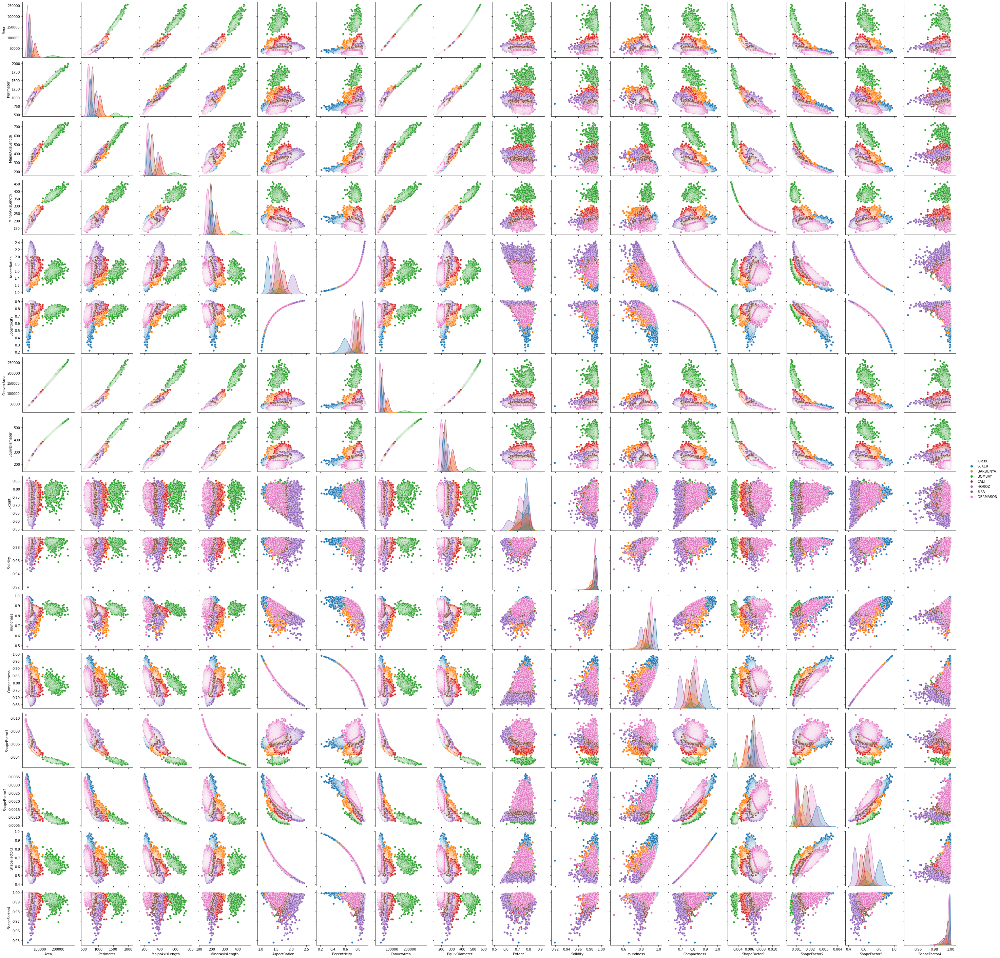

In [5]:
sb.pairplot(dry_beans_data.dropna(), hue='Class');

## Pre Processing of Data <a id="preprocessing"></a>

In [7]:
dry_beans_data.loc[dry_beans_data['Area'].isnull() | dry_beans_data['Perimeter'].isnull() |
                  dry_beans_data['MajorAxisLength'].isnull() | dry_beans_data['MinorAxisLength'].isnull() |
                   dry_beans_data['Eccentricity'].isnull() | dry_beans_data['ConvexArea'].isnull() |
                   dry_beans_data['EquivDiameter'].isnull() | dry_beans_data['Solidity'].isnull() |
                   dry_beans_data['Extent'].isnull() | dry_beans_data['roundness'].isnull() |
                   dry_beans_data['Compactness'].isnull() |
                   dry_beans_data['ShapeFactor1'].isnull() | dry_beans_data['ShapeFactor2'].isnull() |
                   dry_beans_data['ShapeFactor3'].isnull() | dry_beans_data['ShapeFactor4'].isnull()
                  ]

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
Unnamed: 0,,,,,,,,,,,,,,,,,


In [8]:
dry_beans_data.loc[dry_beans_data['Area'].isna() | dry_beans_data['Perimeter'].isna() |
                  dry_beans_data['MajorAxisLength'].isna() | dry_beans_data['MinorAxisLength'].isna() |
                   dry_beans_data['Eccentricity'].isna() | dry_beans_data['ConvexArea'].isna() |
                   dry_beans_data['EquivDiameter'].isna() | dry_beans_data['Solidity'].isna() |
                   dry_beans_data['Extent'].isna() | dry_beans_data['roundness'].isna() |
                   dry_beans_data['Compactness'].isna() |
                   dry_beans_data['ShapeFactor1'].isna() | dry_beans_data['ShapeFactor2'].isna() |
                   dry_beans_data['ShapeFactor3'].isna() | dry_beans_data['ShapeFactor4'].isna()
                  ]

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
Unnamed: 0,,,,,,,,,,,,,,,,,


#### Histogramas para *SEKER*

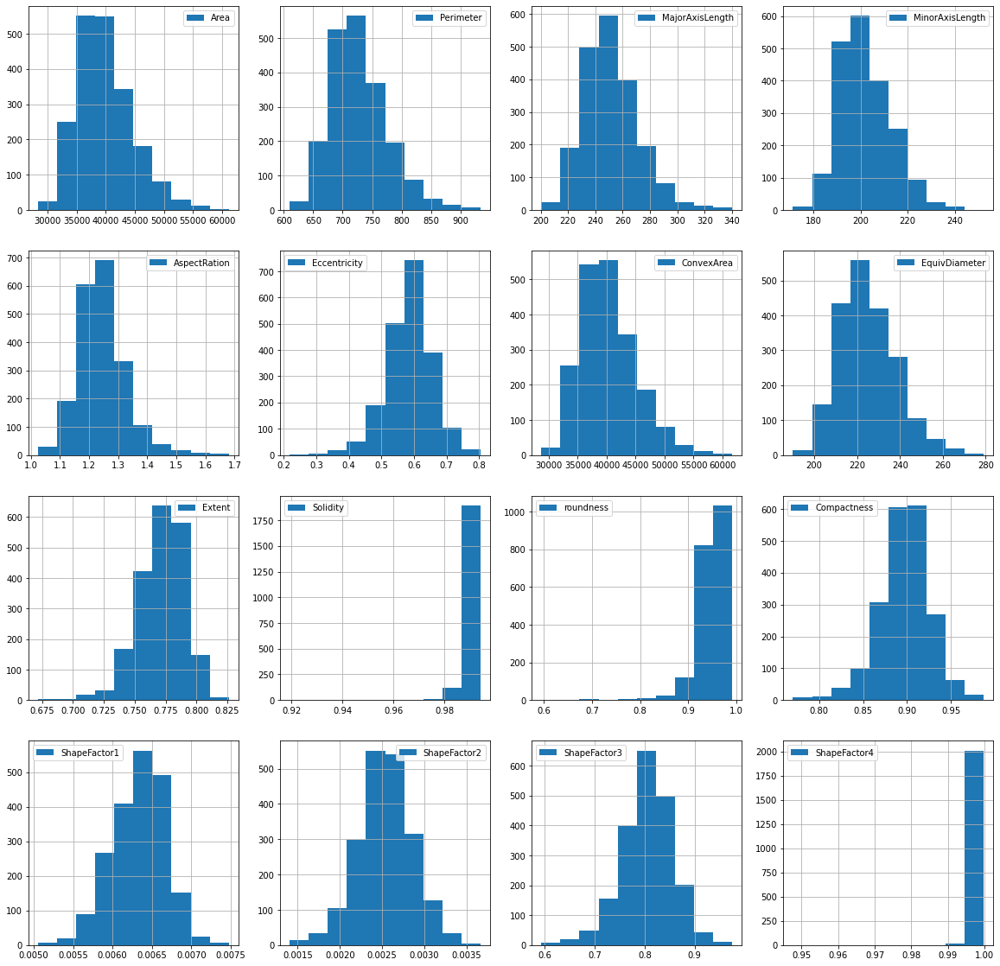

In [9]:
plt.figure(figsize=(20, 20))
for column_index, columnName in enumerate(dry_beans_data.columns):
    if columnName == 'Class':
        continue
    plt.subplot(4, 4, column_index + 1)
    dry_beans_data.loc[dry_beans_data['Class'] == 'SEKER', columnName].hist(legend='true')

Analisando os histogramas acima, verificamos que no histograma de **Solidity** do feijão da classe *Seker*, verificámos que a maioria dos feijões tem um valor igual ou superior a 0.98, por isso concluímos que valores abaixo seriam outliers logo decidimo-los remover, já que para além disso verificámos que são apenas 14 dos 2027 feijões deste tipo.

<AxesSubplot:>

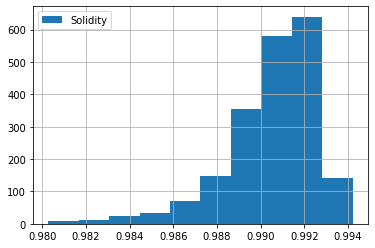

In [10]:
dry_beans_data = dry_beans_data.loc[(dry_beans_data['Solidity'] >= 0.98) | (dry_beans_data['Class'] != 'SEKER')]
dry_beans_data.loc[dry_beans_data['Class'] == 'SEKER', 'Solidity'].hist(legend='true')

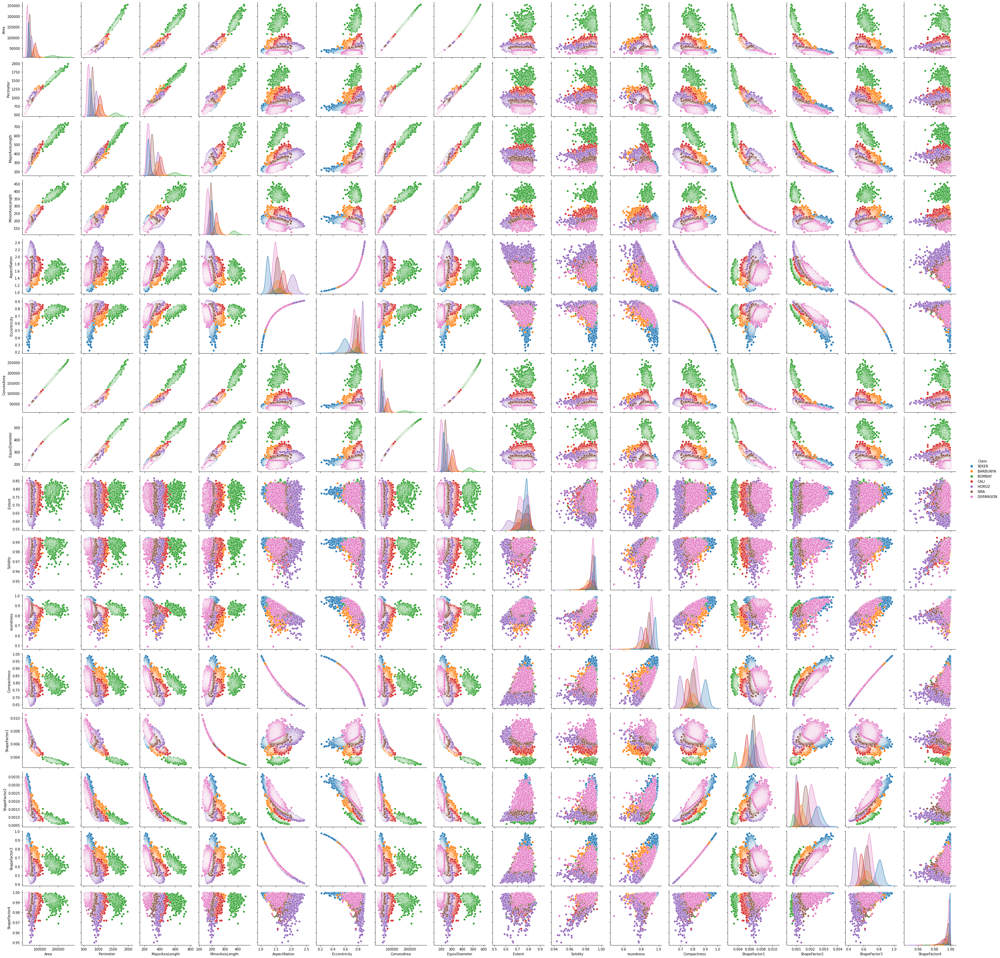

In [11]:
sb.pairplot(dry_beans_data.dropna(), hue='Class')

É possivel verificar-se também que no histograma de **roundness** do feijão da classe *Seker*, verificámos que a maioria dos feijões tem um valor igual ou superior a 0.65, por isso concluímos que valores abaixo seriam outliers logo decidimo-los remover, já que para além disso verificámos que são apenas 3 dos 3546 feijões deste tipo.

<AxesSubplot:>

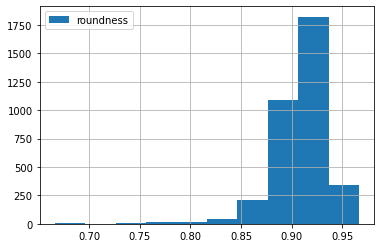

In [23]:
dry_beans_data.loc[dry_beans_data['Class'] == 'DERMASON', 'roundness'].hist(legend='true')

<AxesSubplot:>

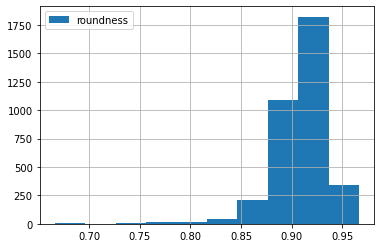

In [24]:
dry_beans_data = dry_beans_data.loc[(dry_beans_data['roundness'] >= 0.65) | (dry_beans_data['Class'] != 'DERMASON')]
dry_beans_data.loc[dry_beans_data['Class'] == 'DERMASON', 'roundness'].hist(legend='true')

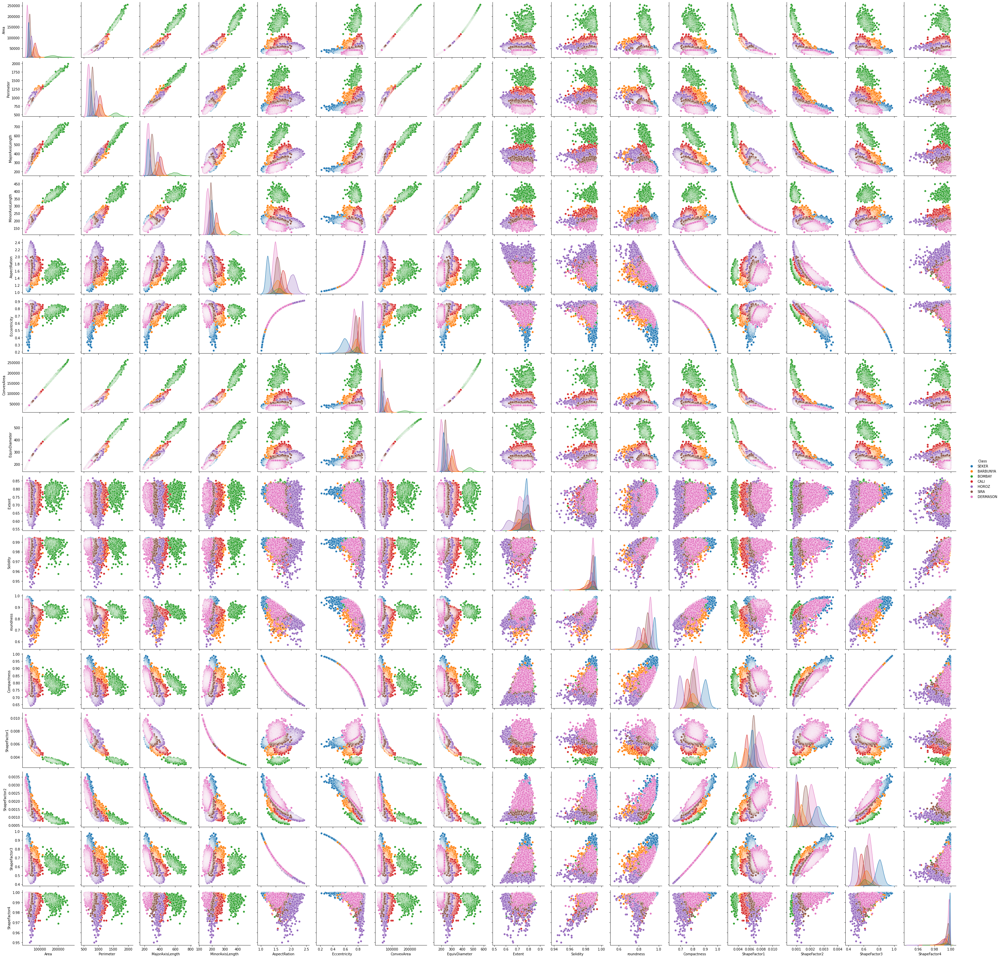

In [20]:
sb.pairplot(dry_beans_data.dropna(), hue='Class')

-> ShapeFactor1, Dermason, > 0.01
-> ShapeFactor4, Cali, < 0.97

<AxesSubplot:>

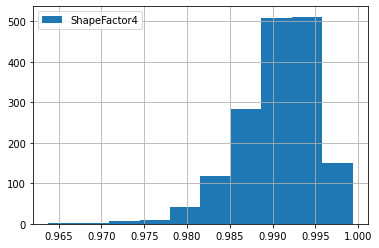

In [25]:
dry_beans_data.loc[dry_beans_data['Class'] == 'CALI', 'ShapeFactor4'].hist(legend='true')

In [26]:
print(dry_beans_data.loc[(dry_beans_data['ShapeFactor4'] < 0.97) & (dry_beans_data['Class'] == 'CALI')])

             Area  Perimeter  MajorAxisLength  MinorAxisLength  AspectRation  \
Unnamed: 0                                                                     
4462        71810   1055.735       385.046183       246.379429      1.562818   

            Eccentricity  ConvexArea  EquivDiameter   Extent  Solidity  \
Unnamed: 0                                                               
4462            0.768483       75224     302.376143  0.73484  0.954616   

            roundness  Compactness  ShapeFactor1  ShapeFactor2  ShapeFactor3  \
Unnamed: 0                                                                     
4462         0.809627     0.785298      0.005362      0.001258      0.616694   

            ShapeFactor4 Class  
Unnamed: 0                      
4462             0.96378  CALI  


**Finding duplicates**

In [27]:
# Number of duplicate elements of each type

cntSekerRepeated = 0
cntBarbunyaRepeated = 0
cntBombayRepeated = 0
cntCaliRepeated = 0
cntHorozRepeated = 0
cntSiraRepeated = 0
cntDermasonRepeated = 0

for i in dry_beans_data.loc[dry_beans_data['Class'] == 'SEKER'].duplicated():
    if i == True: cntSekerRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'BARBUNYA'].duplicated():
    if i == True: cntBarbunyaRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'BOMBAY'].duplicated():
    if i == True: cntBombayRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'CALI'].duplicated():
    if i == True: cntCaliRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'HOROZ'].duplicated():
    if i == True: cntHorozRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'SIRA'].duplicated():
    if i == True: cntSiraRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'DERMASON'].duplicated():
    if i == True: cntDermasonRepeated += 1
        
print("Reapeated SEKER: %d" % cntSekerRepeated)
print("Reapeated BARBUNYA: %d" % cntBarbunyaRepeated)
print("Reapeated BOMBAY: %d" % cntBombayRepeated)
print("Reapeated CALI: %d" % cntCaliRepeated)
print("Reapeated HOROZ: %d" % cntHorozRepeated)
print("Reapeated SIRA: %d" % cntSiraRepeated)
print("Reapeated DERMASON: %d" % cntDermasonRepeated)

Reapeated SEKER: 0
Reapeated BARBUNYA: 0
Reapeated BOMBAY: 0
Reapeated CALI: 0
Reapeated HOROZ: 68
Reapeated SIRA: 0
Reapeated DERMASON: 0


As we can see there is 68 elements of bean HOROZ that are duplicated so we need to remove them

In [28]:
# Eliminating duplicated elements
dry_beans_data = dry_beans_data.drop_duplicates()

In [29]:
# Number of duplicate elements of each type

cntSekerRepeated = 0
cntBarbunyaRepeated = 0
cntBombayRepeated = 0
cntCaliRepeated = 0
cntHorozRepeated = 0
cntSiraRepeated = 0
cntDermasonRepeated = 0

for i in dry_beans_data.loc[dry_beans_data['Class'] == 'SEKER'].duplicated():
    if i == True: cntSekerRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'BARBUNYA'].duplicated():
    if i == True: cntBarbunyaRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'BOMBAY'].duplicated():
    if i == True: cntBombayRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'CALI'].duplicated():
    if i == True: cntCaliRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'HOROZ'].duplicated():
    if i == True: cntHorozRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'SIRA'].duplicated():
    if i == True: cntSiraRepeated += 1
        
for i in dry_beans_data.loc[dry_beans_data['Class'] == 'DERMASON'].duplicated():
    if i == True: cntDermasonRepeated += 1
        
print("Reapeated SEKER: %d" % cntSekerRepeated)
print("Reapeated BARBUNYA: %d" % cntBarbunyaRepeated)
print("Reapeated BOMBAY: %d" % cntBombayRepeated)
print("Reapeated CALI: %d" % cntCaliRepeated)
print("Reapeated HOROZ: %d" % cntHorozRepeated)
print("Reapeated SIRA: %d" % cntSiraRepeated)
print("Reapeated DERMASON: %d" % cntDermasonRepeated)

Reapeated SEKER: 0
Reapeated BARBUNYA: 0
Reapeated BOMBAY: 0
Reapeated CALI: 0
Reapeated HOROZ: 0
Reapeated SIRA: 0
Reapeated DERMASON: 0


All duplicated values were removed

In [30]:
# Number of elements of each class
print("SEKER: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'SEKER']))
print("BARBUNYA: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'BARBUNYA']))
print("BOMBAY: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'BOMBAY']))
print("CALI: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'CALI']))
print("HOROZ: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'HOROZ']))
print("SIRA: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'SIRA']))
print("DERMASON: %d" % len(dry_beans_data.loc[dry_beans_data['Class'] == 'DERMASON']))

SEKER: 2013
BARBUNYA: 1322
BOMBAY: 522
CALI: 1630
HOROZ: 1860
SIRA: 2636
DERMASON: 3543


As we can see the samples of each bean type are not balanced, so we need to balance them some how. 
As the smaller sample size is 522 of BOMBAY, we decided to make samples of size 500.

In [31]:
# Select 500 elements of each type
sample_size = 500

seker_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'SEKER'].sample(n = sample_size)
barbunya_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'BARBUNYA'].sample(n = sample_size)
bombay_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'BOMBAY'].sample(n = sample_size)
cali_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'CALI'].sample(n = sample_size)
horoz_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'HOROZ'].sample(n = sample_size)
sira_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'SIRA'].sample(n = sample_size)
dermason_sample = dry_beans_data.loc[dry_beans_data['Class'] == 'DERMASON'].sample(n = sample_size)

sample = pd.concat([seker_sample, barbunya_sample, bombay_sample, cali_sample, horoz_sample, sira_sample, dermason_sample])

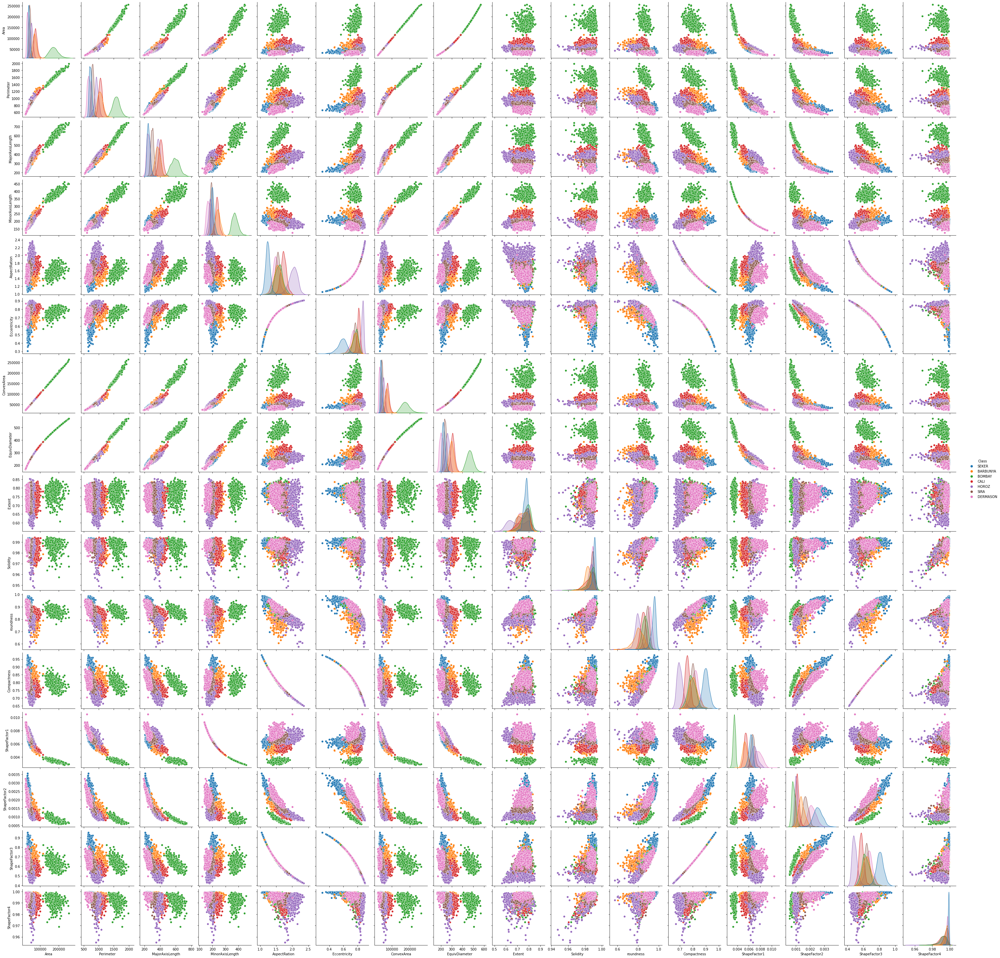

In [32]:
sb.pairplot(sample.dropna(), hue='Class')

---

## Violin Plots

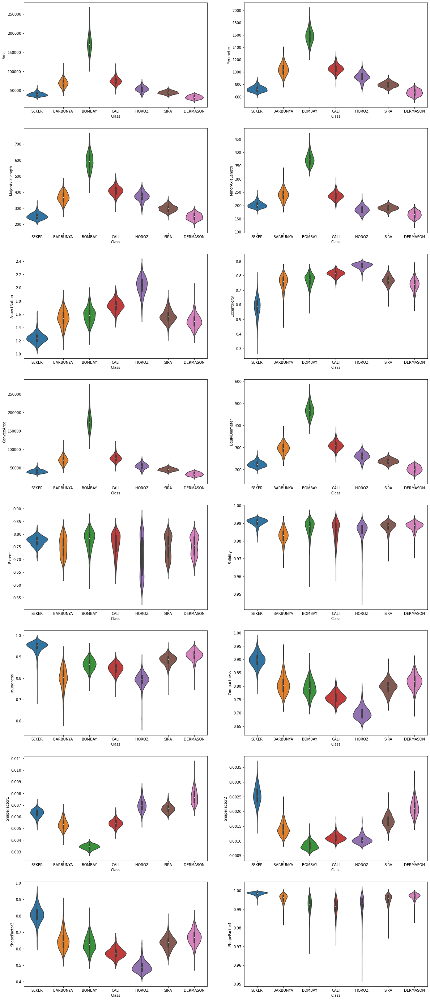

In [33]:
plt.figure(figsize=(20, 50))

for column_index, column in enumerate(sample.columns):
    if column == 'Class':
        continue
    plt.subplot(8, 2, column_index + 1)
    sb.violinplot(x='Class', y=column, data=sample)

Analisando os gráficos violinos verificamos que os atributos: Shapefactor4, Extent e Solidity não são muito úteis para usar como atributos de decisão já que os seus valores são idênticos para todos os tipos de feijão, logo decidimos remove-los reduzindo assim a sua dimensionalidade tornando mais simples o nosso dataset.

(Update: não foram retirados)

In [35]:
dry_beans_data1 = sample[['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
                        'AspectRation', 'Eccentricity', 'ConvexArea', 'EquivDiameter',
                        'ShapeFactor4', 'Solidity', 'Extent', 'roundness', 'Compactness',
                        'ShapeFactor1', 'ShapeFactor2', 'ShapeFactor3', 'Class']]

**B-TREE**

In [36]:
inputs = dry_beans_data1[['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
                        'AspectRation', 'Eccentricity', 'ConvexArea', 'EquivDiameter',
                        'ShapeFactor4', 'Solidity', 'Extent', 'roundness', 'Compactness',
                        'ShapeFactor1', 'ShapeFactor2', 'ShapeFactor3']].values

labels = dry_beans_data1['Class'].values

Split Data

Em relação ao tamanho do conjunto de teste não tenho a certeza, talvez tenha de se variar

In [37]:
(training_inputs, testing_inputs, training_classes, testing_classes) = train_test_split(inputs, labels, test_size = 0.25, random_state = 1)

## Classification Techiques, Evaluation & Prediction <a id="classification"></a>
### Decision Tree <a id="decision-tree"></a>

In [38]:
decision_tree_classifier = DecisionTreeClassifier() #classificador

decision_tree_classifier.fit(training_inputs, training_classes) #modelo

decision_tree_classifier.score(testing_inputs, testing_classes)

0.9005714285714286

(array([ 7.,  3.,  9., 14., 18., 22., 16.,  4.,  5.,  2.]),
 array([0.88  , 0.8848, 0.8896, 0.8944, 0.8992, 0.904 , 0.9088, 0.9136,
        0.9184, 0.9232, 0.928 ]),
 <BarContainer object of 10 artists>)

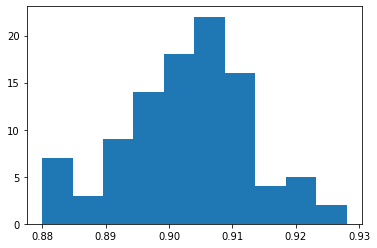

In [39]:
model_accuracies = []

for repetition in range(100):
    (training_inputs,
     testing_inputs,
     training_classes,
     testing_classes) = train_test_split(inputs, labels, test_size=0.25)
    
    decision_tree_classifier = DecisionTreeClassifier()
    decision_tree_classifier.fit(training_inputs, training_classes)
    classifier_accuracy = decision_tree_classifier.score(testing_inputs, testing_classes)
    model_accuracies.append(classifier_accuracy)
    
plt.hist(model_accuracies)

Usando Cross Validation

Text(0.5, 1.0, 'Average score: 0.9')

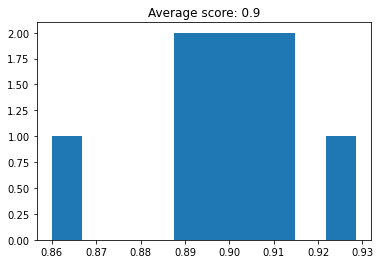

In [43]:
decision_tree = DecisionTreeClassifier()

cv_scores = cross_val_score(decision_tree, inputs, labels, cv=10)
plt.hist(cv_scores)


plt.title('Average score: {}'.format(np.mean(cv_scores)))

Removemos a área e o permietro uma vez que pensamos que pode ser obtidos a partir dos outros parametros

Text(0.5, 1.0, 'Average score: 0.9111428571428573')

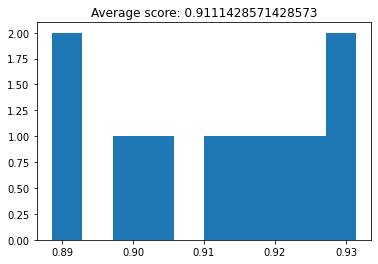

In [44]:
decision_tree_classifier = DecisionTreeClassifier(max_depth=6)

cv_scores = cross_val_score(decision_tree_classifier, inputs, labels, cv=10)
plt.hist(cv_scores)
plt.title('Average score: {}'.format(np.mean(cv_scores)))

In [45]:
decision_tree_classifier = DecisionTreeClassifier()

parameter_grid = {'max_depth': [1, 2, 3, 4, 5, 6, 7, 8],
                  'max_features': [1, 2, 3, 4, 5, 6, 7, 8]}

cross_validation = StratifiedKFold(n_splits=10)

grid_search = GridSearchCV(decision_tree_classifier,
                           param_grid=parameter_grid,
                           cv=cross_validation)

grid_search.fit(inputs, labels)
print('Best score: {}'.format(grid_search.best_score_))
print('Best parameters: {}'.format(grid_search.best_params_))

Best score: 0.9117142857142857
Best parameters: {'max_depth': 7, 'max_features': 8}


''

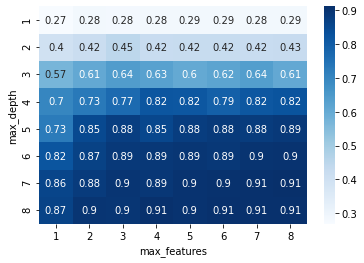

In [46]:
grid_visualization = grid_search.cv_results_['mean_test_score']
grid_visualization.shape = (8, 8)
sb.heatmap(grid_visualization, cmap='Blues', annot=True)
plt.xticks(np.arange(8) + 0.5, grid_search.param_grid['max_features'])
plt.yticks(np.arange(8) + 0.5, grid_search.param_grid['max_depth'])
plt.xlabel('max_features')
plt.ylabel('max_depth')
;

In [47]:
decision_tree_classifier = DecisionTreeClassifier()

parameter_grid = {'criterion': ['gini', 'entropy'],
                  'splitter': ['best', 'random'],
                  'max_depth': [1, 2, 3, 4, 5, 6, 7, 8],
                  'max_features': [1, 2, 3, 4, 5, 6, 7, 8]}

cross_validation = StratifiedKFold(n_splits=10)

grid_search = GridSearchCV(decision_tree_classifier,
                           param_grid=parameter_grid,
                           cv=cross_validation)

grid_search.fit(inputs, labels)
print('Best score: {}'.format(grid_search.best_score_))
print('Best parameters: {}'.format(grid_search.best_params_))

Best score: 0.9168571428571427
Best parameters: {'criterion': 'entropy', 'max_depth': 8, 'max_features': 8, 'splitter': 'best'}


### Nearest Neighbor <a id="k-nn"></a>
### Naïve Bayes <a id="nb"></a>
### Support Vector Machines <a id="svm"></a>
### Neural Networks <a id="ann"></a>  

## Conclusion <a id="conclusion"></a>